# SwinWNet: A Deep Learning framework for multimodal processing of 2D neutron diffraction data  
## Official Tutorial & Usage Guide

**SwinWNet** is a deep learning framework for multimodal processing of 2D neutron diffraction data. The model is built on a two-tower architecture, where different towers are responsible for segmentation and upscaling of diffraction patterns. The connection between the towers is achieved through cross-attention between the encoders of the two towers, as described in the original paper: 

> *"SwinWNet: A Multimodal dual-branch Swin Transformer framework for 2D Neutron Diffraction Postprocessing"*

This tutorial provides a step-by-step guide on how to use the framework for inference on provided test data, as well as instructions for training the model on your own datasets.

---

In [1]:
import torch
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

print(torch.cuda.is_available())
device = 'cuda' if torch.cuda.is_available() else 'cpu'

True


## 📂 Data Loading

To demonstrate the functionality of the framework, the authors provide **6 diffraction patterns**, each corresponding to different crystal structures. These examples allow users to understand the workflow of the model and test the complete inference pipeline.

You can load them into this notebook as follows:

In [19]:
import pickle

with open('datasets/test_data.pkl', 'rb') as f:
    loaded_dict = pickle.load(f)
    
crystals = loaded_dict['crystal_structure']
diffractions = loaded_dict['diffractions_error_matrix']
masks = loaded_dict['binary_masks']

print(diffractions.size())
print(masks.size())

torch.Size([6, 2, 250, 480])
torch.Size([6, 250, 480])


C:\Users\neUral\AppData\Roaming\Python\Python312\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 8491 (\N{ANGSTROM SIGN}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)


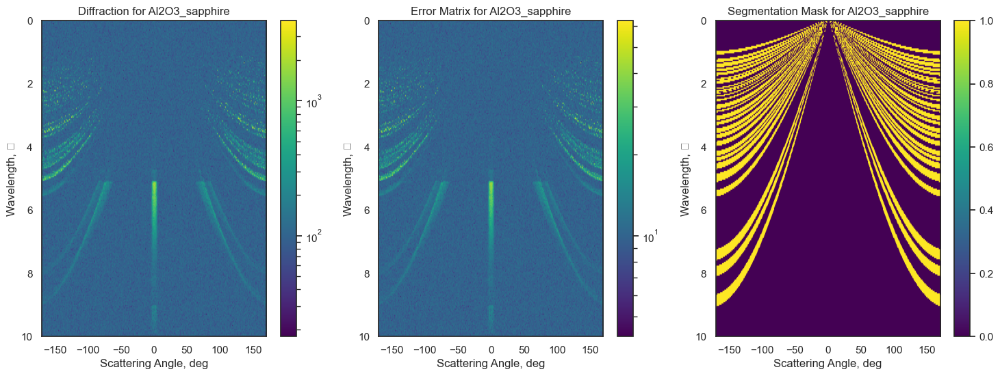

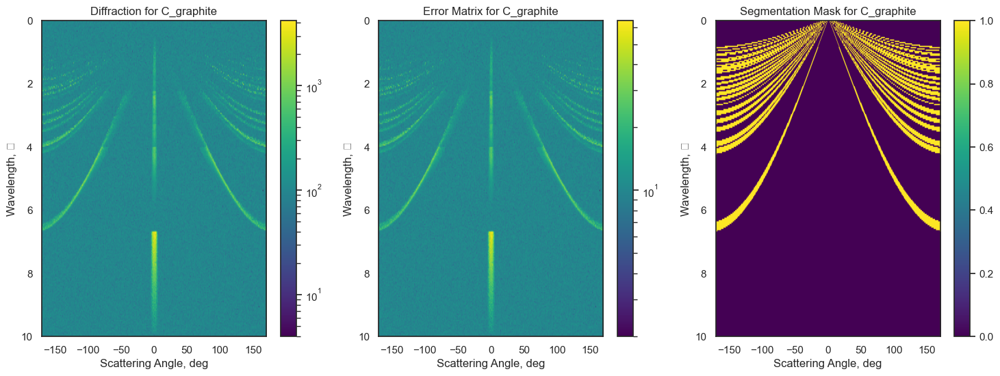

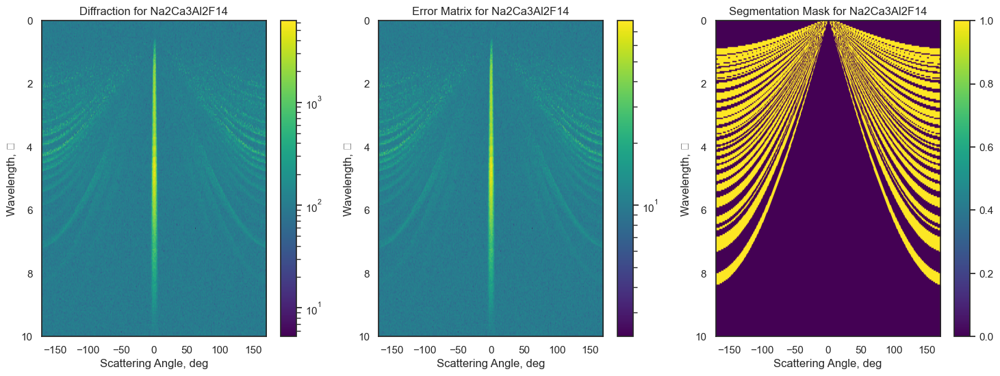

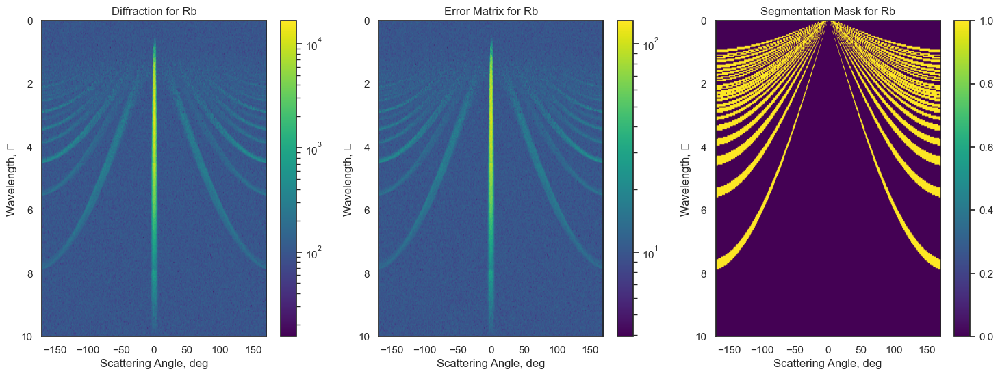

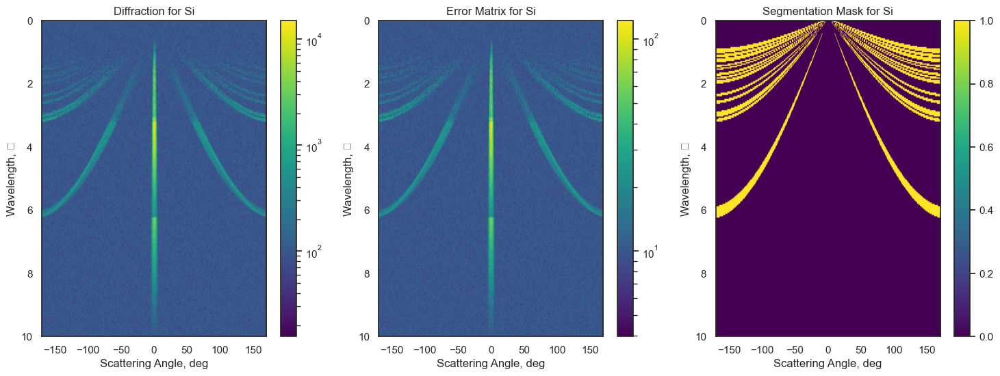

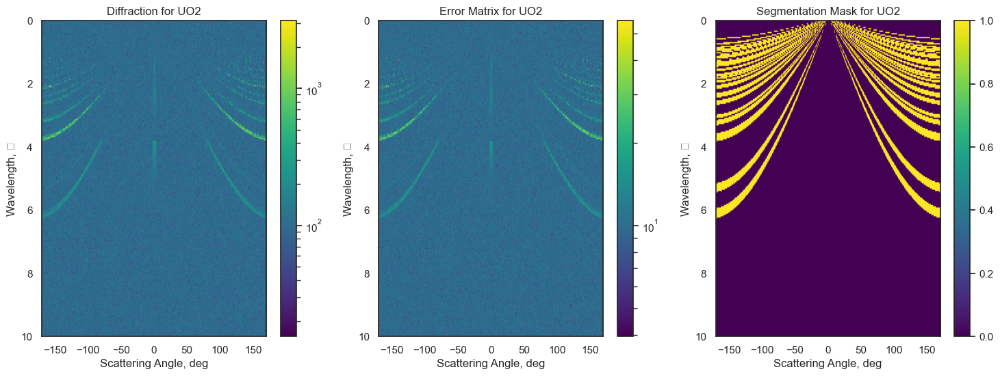

In [ ]:
for data, mask, crystal in zip(diffractions, masks, crystals):
    diffraction = data[0].cpu().numpy()
    error_matrix = data[1].cpu().numpy()

    fig, (ax1, ax2 ,ax3) = plt.subplots(1, 3, figsize=(18, 6))

    im1 = ax1.imshow(diffraction, cmap='viridis', aspect='auto', norm='log', extent=(-170, 170, 10, 0))
    ax1.set_xlabel('Scattering Angle, deg')
    ax1.set_ylabel('Wavelength, Å')
    ax1.set_title(f'Diffraction for {crystal}')
    plt.colorbar(im1)

    im2 = ax2.imshow(error_matrix, cmap='viridis', aspect='auto', norm='log', extent=(-170, 170, 10, 0))
    ax2.set_xlabel('Scattering Angle, deg')
    ax2.set_ylabel('Wavelength, Å')
    ax2.set_title(f'Error Matrix for {crystal}')
    plt.colorbar(im2)

    im3 = ax3.imshow(mask.numpy(), cmap='viridis', aspect='auto', extent=(-170, 170, 10, 0))
    ax3.set_xlabel('Scattering Angle, deg')
    ax3.set_ylabel('Wavelength, Å')
    ax3.set_title(f'Segmentation Mask for {crystal}')
    plt.colorbar(im3)

    plt.show()

***
Based on these provided structures, we will demonstrate:

- 🔹 How to run inference using the pre-trained model
- 🔹 How to perform training
- 🔹 How to run validation and testing
- 🔹 How to visualize the results
- 🔹 How to adapt the pipeline to your own datasets

***

### ⚠️ **Important: Using Your Own Data**

If you plan to train the model on your own diffraction data:

**1. Pre-processing is required.**
Your data must be transformed into a format compatible with the model input, similar to the provided test dataset.

**2. You need to implement a <DataLoader>.**
It should properly load data for:

* training (<train>)
* validation (<val>)
* testing (<test>)

The output format of the <DataLoader> must match the structure used in this tutorial.

**3. Code modifications may be necessary.**
If your data format differs from the expected structure, you may need to modify the framework’s provided functions for:

* training
* testing
* inference

***

### 💡 **Recommendations**

* First, run the full tutorial using the provided test data.
* Then, gradually adapt preprocessing and the DataLoader for your own dataset.
* Always verify input tensor dimensions before starting training.
* Ensure that normalization and scaling match those used during pre-training.

Following these steps will help you avoid common issues when adapting the framework to new experimental datasets.

In [21]:
from torch.utils.data import TensorDataset, DataLoader

dataset = TensorDataset(diffractions, masks)
train_loader = DataLoader(dataset, batch_size=1, shuffle=True)
test_loader = DataLoader(dataset, batch_size=1, shuffle=True)

for batch_idx, (diff_batch, mask_batch) in enumerate(train_loader):
    print(f"Batch {batch_idx}:")
    print(f"  Diffractions shape: {diff_batch.shape}")
    print(f"  Masks shape: {mask_batch.shape}")
    break

Batch 0:
  Diffractions shape: torch.Size([1, 2, 250, 480])
  Masks shape: torch.Size([1, 250, 480])


## 🔧 Model Initialization

The authors aim to provide **maximum flexibility for hyperparameter configuration** and architectural customization.  
For this reason, the model initialization is fully configurable and allows detailed control over the network components.

You can define:

- 🔹 Model depth and number of layers  
- 🔹 Embedding dimensions  
- 🔹 Number of attention heads  
- 🔹 Window size  
- 🔹 Wavelet-related parameters  
- 🔹 Segmentation and regression branch settings  
- 🔹 Dropout rates and other regularization parameters  

This design allows:

- Reproducing the exact configuration from the paper  
- Performing ablation studies  
- Scaling the architecture for larger or smaller datasets  
- Adapting the model to different diffraction pattern resolutions  

Model initialization is performed as shown below:


In [22]:
from SwinWNet import SwinWNet

# Создаем модель
model = SwinWNet(
    patch_size=2, 
    in_chans=1, 
    error_matrix=True, 
    embed_dim=48, 
    depths=[2, 2, 2, 2], 
    num_heads=[3, 6, 12, 24],
    window_size=5, 
    mlp_ratio=4., 
    qkv_bias=True, 
    drop=0., 
    attn_drop=0., 
    drop_path=0.
).to(device)

# 🏋️ Training

As described in the original paper, model training is performed in multiple stages.  
The first stage is **supervised training** using standard loss functions.

---

## Stage 1: Supervised Pre-training of the Segmentation Tower

The first sub-stage of supervised training is **pre-training the segmentation tower**.

This step initializes the segmentation branch of the network before proceeding to the full multi-task training procedure.

The segmentation pre-training can be performed as shown in the code cell below.

> ⚙️ The training class requires `train_loader` and `test_loader` as input arguments.

You may also optionally specify:

- 🔹 **Optimizer** (e.g., Adam, AdamW, SGD)  
- 🔹 **Learning rate scheduler**  
- 🔹 Their corresponding hyperparameters  
- 🔹 Segmentation loss function  
- 🔹 Number of training epochs  

If the optimizer and scheduler are **not explicitly provided**, the framework will automatically initialize the same optimizer and scheduler configuration used by the authors in the original paper.

This ensures reproducibility of the reported results while still allowing flexibility for experimentation.

---

### 🔧 Customization Options

During segmentation pre-training, you can:

- Adjust learning rate and weight decay  
- Modify scheduler strategy (StepLR, CosineAnnealing, etc.)  
- Experiment with different segmentation loss functions  
- Control the total number of epochs  

This flexibility allows you to:
- Reproduce the original training setup  
- Fine-tune hyperparameters for your own dataset  
- Adapt the model to different data distributions  

The next cell demonstrates how to initialize and launch segmentation pre-training.


In [ ]:
from Segmentator_pretrain import SegmentatorTrainer

seg_trainer = SegmentatorTrainer(
    model=model,
    train_loader=train_loader,
    val_loader=test_loader,
    device=device,
    loss='CombinedLoss',      # DiceLoss, TverskyLoss, FocalTverskyLoss, FocalBCE, CombinedLoss
    optimizer=None,      # if None → create default
    scheduler=None,      # if None → create default
    num_epochs=300,
    use_fp16=True
)

seg_trainer.train()
seg_trainer.release_training_state()

## Stage 2: Supervised Pre-training of the Upscaling Tower

The second stage of supervised pre-training is **pre-training the upscaling tower**.

At this step, the reconstruction branch of the network is trained independently before proceeding to joint or advanced training stages.

The training mechanism here is implemented аналогously to the segmentation tower pre-training.

> ⚙️ You need to provide the appropriate `train_loader` and `test_loader` when initializing the training class.

---

### 🔧 Customization Options

You can configure:

- 🔹 A custom **optimizer**
- 🔹 A custom **learning rate scheduler**
- 🔹 Their corresponding hyperparameters
- 🔹 The number of training **epochs**
- 🔹 The **reconstruction loss function**

If the optimizer and scheduler are **not specified**, the framework will automatically initialize the default configuration used by the authors during the training of the model presented in the paper.

This ensures reproducibility while maintaining full flexibility for adapting the training process to your own datasets and experimental setups.

The following code cell demonstrates how to launch the supervised pre-training of the upscaling tower.


In [ ]:
from Upscaler_pretrain import UpscalerTrainer

ups_trainer = UpscalerTrainer(
    model=model,
    train_loader=train_loader,
    val_loader=test_loader,
    device=device,
    loss='SmoothL1Loss',      # MSELoss, L1Loss, SmoothL1Loss
    optimizer=None,      # if None → create default
    scheduler=None,      # if None → create default
    num_epochs=50,
    use_fp16=True
)

ups_trainer.train()
seg_trainer.release_training_state()

## Stage 3: Full Joint Training

The third stage is **full model training**, no longer separate pre-training.

At this stage, both towers — the **segmentation tower** and the **upscaling tower** — are trained jointly within the complete pipeline described in the paper. The network operates as a unified multi-branch architecture, and optimization is performed end-to-end.

This stage allows the model to:

- 🔹 Learn joint feature representations  
- 🔹 Align segmentation and reconstruction objectives  
- 🔹 Improve overall structural prediction performance  
- 🔹 Fine-tune all components in a unified training loop  

---

### 🔧 Customization Options

From a configuration standpoint, this stage provides the same level of flexibility as the individual tower pre-training stages.

You can configure:

- 🔹 Custom **optimizer**
- 🔹 Custom **learning rate scheduler**
- 🔹 Corresponding hyperparameters
- 🔹 Number of training **epochs**
- 🔹 Loss functions (for both segmentation and reconstruction branches)
- 🔹 Weighting between different loss components (if supported in your setup)

If no optimizer or scheduler is provided, the framework initializes the default configuration used by the authors in the original study.

This ensures:

- Reproducibility of reported results  
- Flexibility for research experiments  
- Easy adaptation to new datasets  

The following code cell demonstrates how to launch the full joint training procedure.


In [ ]:
from FullModel_supervised_trainer import FullModelTrainer

FullModel_trainer = FullModelTrainer(
    model=model,
    train_loader=train_loader,
    val_loader=test_loader,
    device=device,
    segmentator_loss='CombinedLoss',      # DiceLoss, TverskyLoss, FocalTverskyLoss, FocalBCE, CombinedLoss
    upscaler_loss='SmoothL1Loss',         # MSELoss, L1Loss, SmoothL1Loss
    optimizer=None,      # if None → create default
    scheduler=None,      # if None → create default
    num_epochs=100,
    seg_weight_lr=1.0,
    seg_weight_hr=1.0,
    rec_weight=1.0
)

FullModel_trainer.train()
FullModel_trainer.release_training_state()

## 🚀 Simplified End-to-End Training Pipeline

For users who do not want to manually configure training hyperparameters  
(e.g., optimizers, schedulers, loss functions, etc.), a **unified training pipeline** is provided.

This pipeline combines all training stages into a single procedure:

1. 🔹 Segmentation tower pre-training  
2. 🔹 Upscaling tower pre-training  
3. 🔹 Full joint training  

The goal of this interface is to:

- Simplify experimentation  
- Reduce setup complexity  
- Provide a clean and reproducible training workflow  
- Allow quick baseline training on new datasets  

---

### ⚙️ Configuration

In this simplified pipeline, you only need to specify:

- 🔹 The number of epochs for segmentation pre-training  
- 🔹 The number of epochs for upscaling pre-training  
- 🔹 The number of epochs for full joint training  

All other components — including optimizer selection, scheduler strategy, and default loss functions — are automatically initialized using the configuration described in the original paper.

This makes the pipeline especially convenient for:

- Quick prototyping  
- Educational purposes  
- Benchmarking new datasets  
- Users who prefer not to manually tune hyperparameters  

The following code cell demonstrates how to launch the complete end-to-end training process.


In [ ]:
from Supervised_train_full_pipline import SwinWNetTrainingPipeline

pipeline = SwinWNetTrainingPipeline(
    model=model,
    train_loader=train_loader,
    val_loader=test_loader,
    device=device,

    # эпохи
    seg_epochs=300,
    sr_epochs=50,
    full_epochs=100
)

pipeline.run()

# RL Fine-Tuning (Beta)

The model presented by the authors was originally designed for **data post-processing with minimal distortions**.  

To assess and minimize distortions introduced by the model, a **RL fine-tuning pipeline** was implemented, where distortions were treated as **penalties**.

> ⚠️ Using these penalties for supervised training is **not possible**, as computing distortion metrics breaks the computational graph, making the metrics **non-differentiable**.

### Features of the RL Fine-Tuning Pipeline:

- Distortions are incorporated as penalties during optimization.
- Helps minimize unwanted changes in the data.
- Not suitable for classical supervised learning.
- Currently in **beta version**.

This approach allows flexible control over post-processing quality, despite the limitations with metric differentiability.


In [ ]:
from experiments.SwinUNet import SwinWNet
from RL_policy import AlphaPolicy

model = SwinWNet(patch_size=2, in_chans=1, error_matrix=True, embed_dim=48, depths=[2, 2, 2, 2], num_heads=[3, 6, 12, 24],
                 window_size=5, mlp_ratio=4., qkv_bias=True, drop=0., attn_drop=0., drop_path=0.).to(device)

model.load_state_dict(torch.load("models/SwinWNet_diffraction+error_matrix.pth", map_location=device))

poilcy = AlphaPolicy().to(device)

In [ ]:
from RL_finetuning_pipline import RLTrainer

RL_trainer = RLTrainer(
    model=model,
    policy=poilcy,
    train_loader=train_loader,
    upscaler_loss = 'SmoothL1Loss',
    device=device,
    optimizer_policy=None,
    optimizer_model=None,
    num_epochs=100,
    lambda_rec=10.0,
    lambda_intensity=2.0,
    lambda_peak=1.0,
    lambda_shape=0.5,
)

RL_trainer.fit()

# Model Loading and Validation

The authors also provide the ability to **validate the optimal model** from the paper on various metrics depending on the task:

### For Segmentation:

- **Pixel Accuracy**
- **IoU (Intersection over Union)**
- **Dice Coefficient**
- **Precision**
- **Recall**

### For Upscaling:

- **PSNR (Peak Signal-to-Noise Ratio)**
- **SSIM (Structural Similarity Index)**

### For Diffraction Peak Analysis:

- Metrics measuring the **divergence of diffraction peak parameters**.

This allows for thorough evaluation of the model's performance across different tasks, ensuring reliable results.


In [ ]:
from experiments.SwinUNet import SwinWNet

model = SwinWNet(patch_size=2, in_chans=1, error_matrix=True, embed_dim=48, depths=[2, 2, 2, 2], num_heads=[3, 6, 12, 24],
                 window_size=5, mlp_ratio=4., qkv_bias=True, drop=0., attn_drop=0., drop_path=0.).to(device)

model.load_state_dict(torch.load("models/SwinWNet_diffraction+error_matrix.pth", map_location=device))

<All keys matched successfully>


========== Segmentation Metrics Low Res ==========

PixelAccuracy
0.25 thrashold PixelAccuracy: mean: 0.9682236115137736, std: 0.012848023919207868
0.50 thrashold PixelAccuracy: mean: 0.9713041683038076, std: 0.012701506365534057
0.75 thrashold PixelAccuracy: mean: 0.9665694336096445, std: 0.013495616814081726
-----------------------------------------------------------------------
IoU
0.25 thrashold IoU: mean: 0.8416398068269094, std: 0.037036468976087
0.50 thrashold IoU: mean: 0.8516416549682617, std: 0.0380943390444087
0.75 thrashold IoU: mean: 0.8198601504166921, std: 0.04154748374544409
-----------------------------------------------------------------------
Dice
0.25 thrashold Dice: mean: 0.9135701258977255, std: 0.021941240614037648
0.50 thrashold Dice: mean: 0.9194147785504659, std: 0.022489617885848502
0.75 thrashold Dice: mean: 0.9004389544328054, std: 0.025212009142460436
-----------------------------------------------------------------------
Precision
0.25 thrashold Precisio


========== Upscaling Metrics Summary Diffraction + Error Matrix ==========

PSNR (dB):
  Mean: 32.4205
  Std: 2.3715
  Min: 29.0744
  Max: 35.8350
  Number of samples: 6
----------------------------------------
SSIM:
  Mean: 0.9555
  Std: 0.0135
  Min: 0.9333
  Max: 0.9704
  Number of samples: 6
----------------------------------------

========== Upscaling Metrics Only Diffraction ==========

PSNR (dB):
  Mean: 35.6180
  Std: 2.4122
  Min: 32.5617
  Max: 39.4795
  Number of samples: 6
----------------------------------------
SSIM:
  Mean: 0.9532
  Std: 0.0163
  Min: 0.9257
  Max: 0.9687
  Number of samples: 6
----------------------------------------

========== Upscaling Metrics Only Error Matrix ==========

PSNR (dB):
  Mean: 30.6095
  Std: 2.3827
  Min: 27.1655
  Max: 33.8818
  Number of samples: 6
----------------------------------------
SSIM:
  Mean: 0.9578
  Std: 0.0112
  Min: 0.9408
  Max: 0.9721
  Number of samples: 6
----------------------------------------



========== Metric of divergence in integrated intensity ==========

Integral intensity:
  Mean: 0.5147
  Std: 0.3846
  Min: 0.1324
  Max: 1.2371
  Number of samples: 6
----------------------------------------

========== Peak intensity divergence metric ==========

Peak intensity:
  Mean: 2.0511
  Std: 1.0739
  Min: 0.3833
  Max: 3.4361
  Number of samples: 6
----------------------------------------

========== Peak shape divergence metric ==========

Peak shape:
  Mean: 0.0441
  Std: 0.0133
  Min: 0.0186
  Max: 0.0568
  Number of samples: 6
----------------------------------------


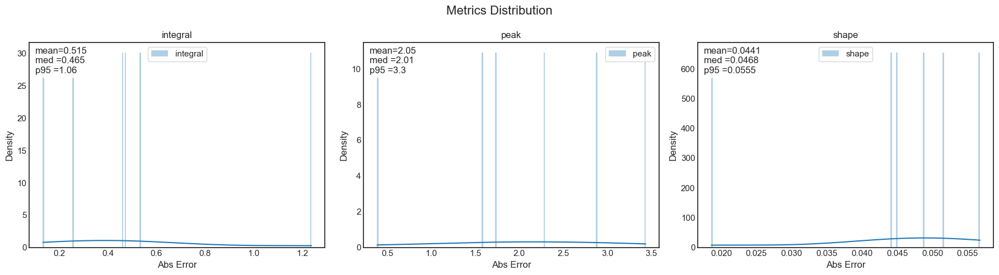

In [ ]:
from tests import MetricsCalculator

MetricsCalc = MetricsCalculator(
        model=model,
        val_loader=test_loader,
        device=device)

segmentation_metrics = MetricsCalc.CalculateSegmentationMetrics()
upscaling_metrics = MetricsCalc.CalculateUpscalerMetrics()
physycal_metrics = MetricsCalc.CalculatePhysycalMetrics()

# Test Dataset Evaluation and Visualization

Once validation is complete, the pipeline enables **evaluation on a test dataset** and the **generation of plots** to visualize:

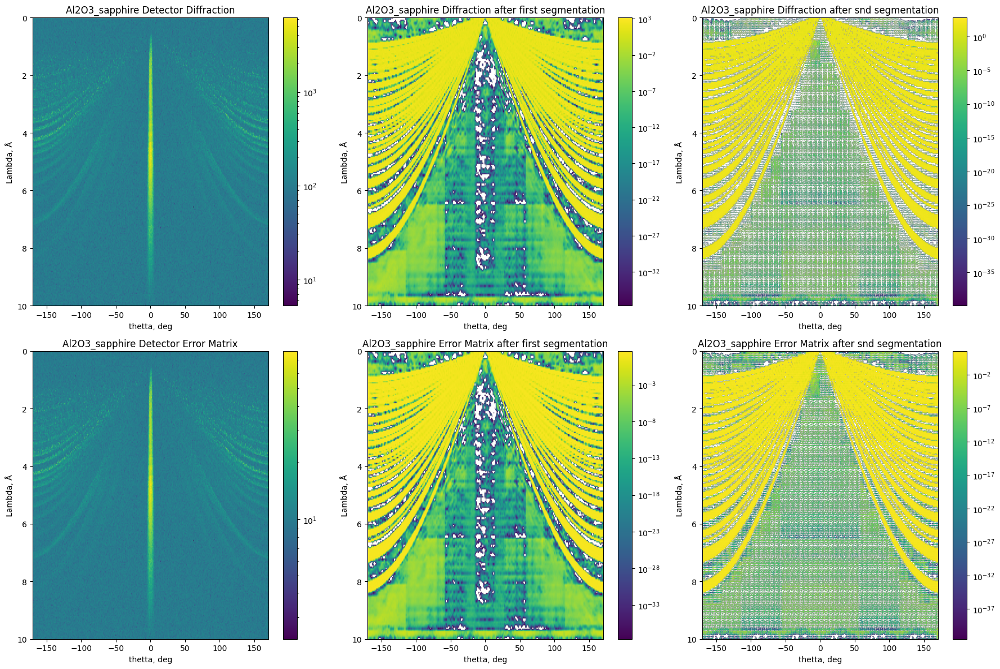

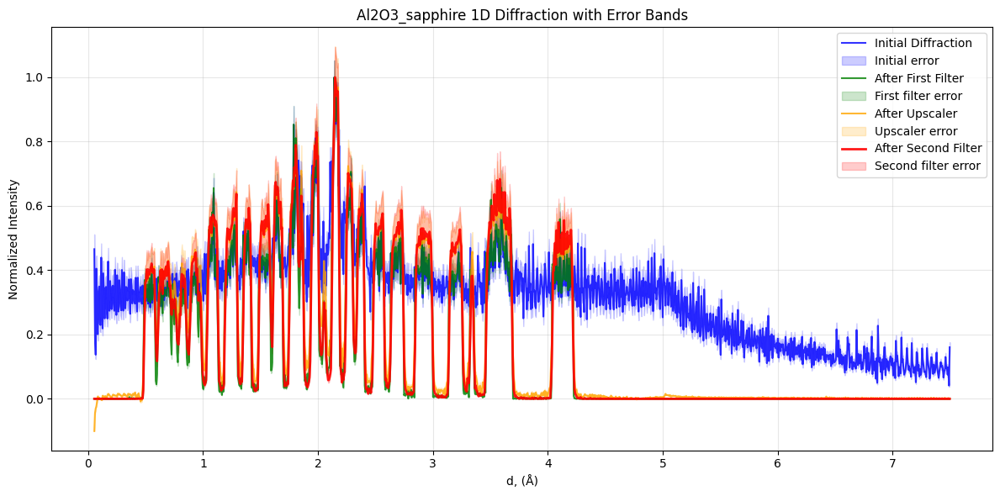

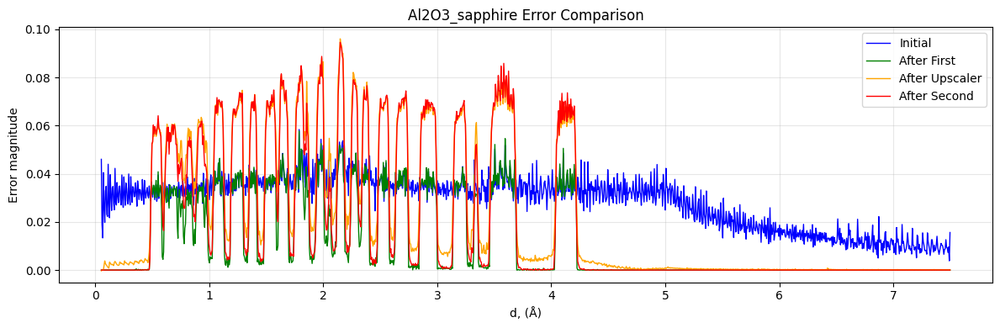

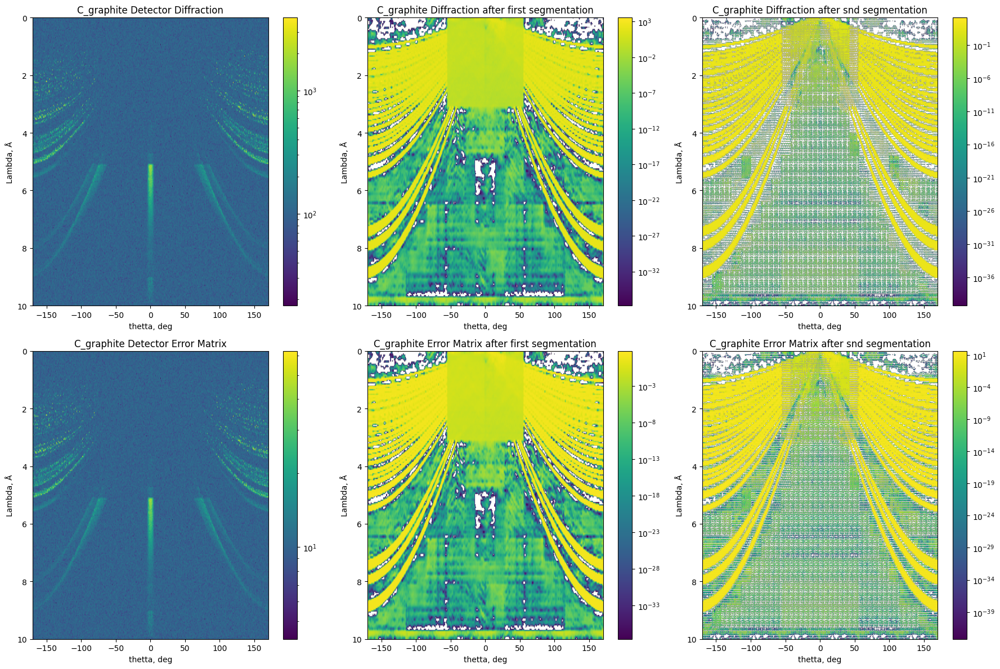

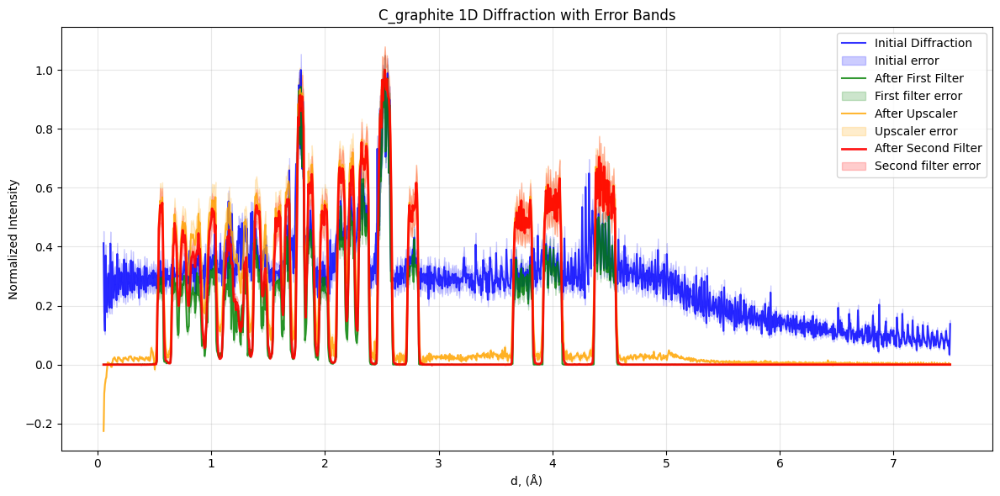

...

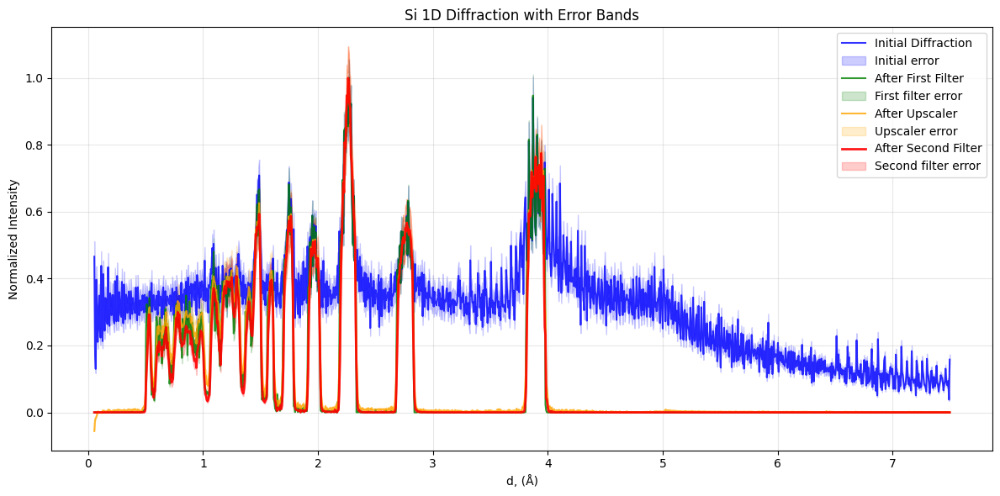

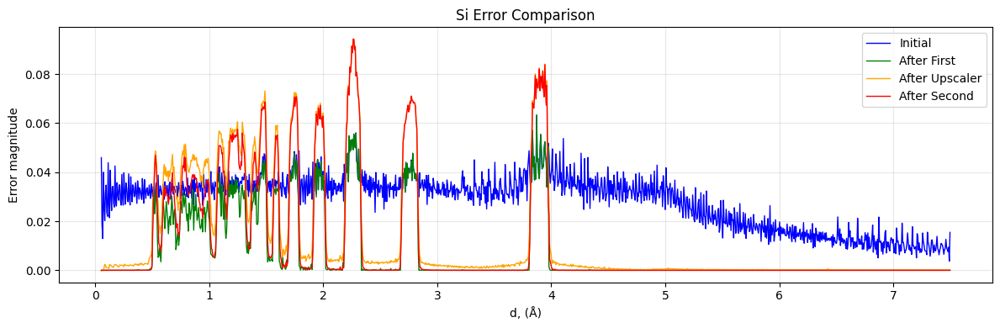

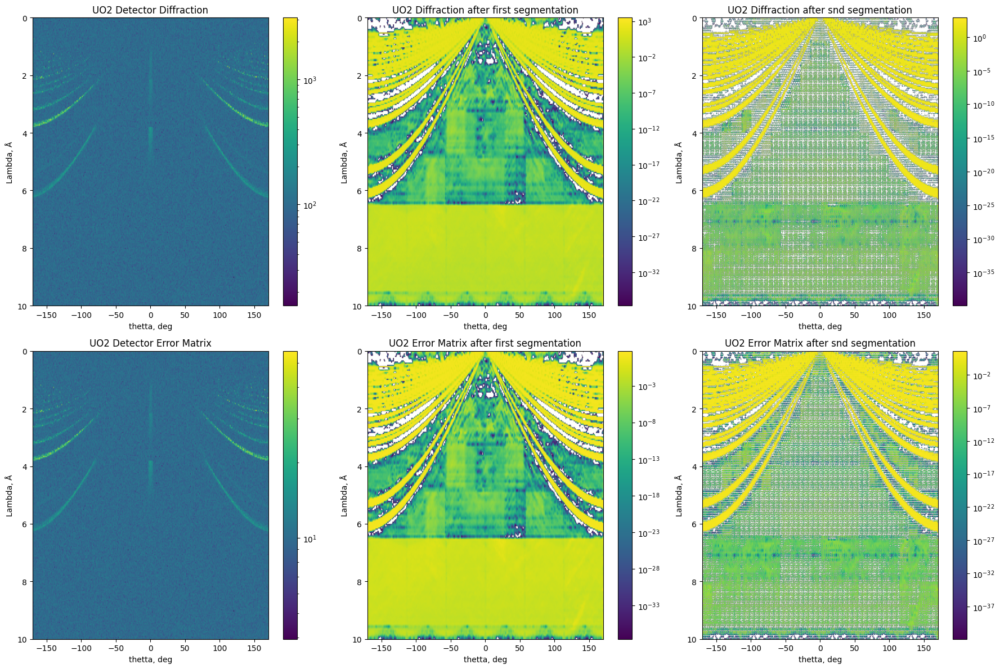

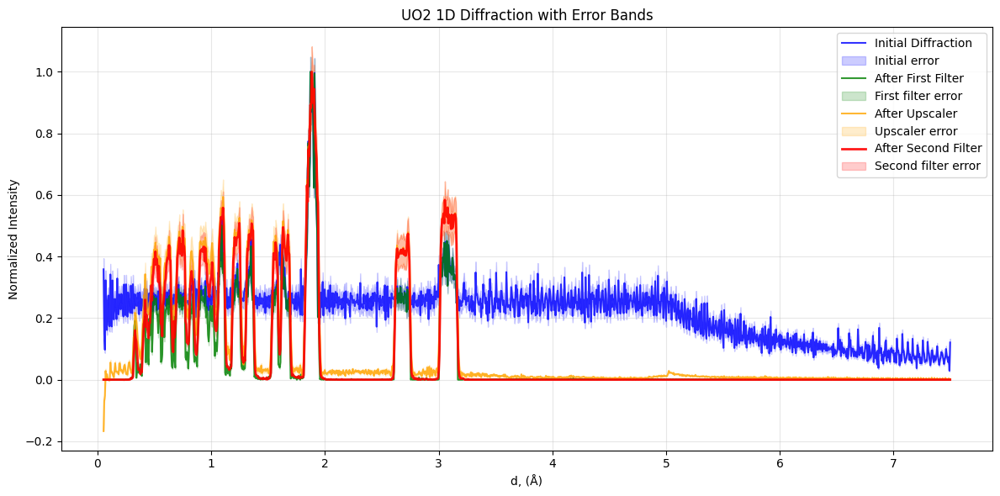

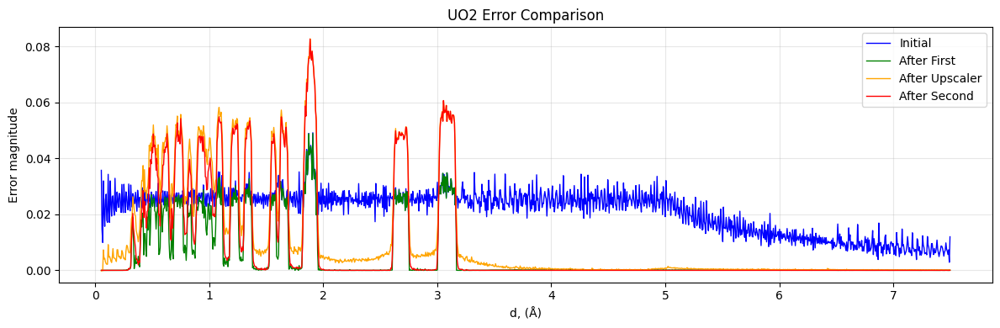

In [ ]:
from ST_Inference_Pipline import SwinWNetInference
from Diffraction_metrics import Qwrapper
import numpy as np
import matplotlib.pyplot as plt

fixed_centers = np.linspace(0.05318052, 7.49710258, 1241)

qw = Qwrapper(
    theta_range=(-170, 170),
    L_range=(0.1, 10),
    fixed_centers=fixed_centers,
    device = device
)

infer = SwinWNetInference(model, device)

for batch_idx, (diff_batch, mask_batch) in enumerate(train_loader):
    diff_batch = diff_batch.to(device)

    result_data = infer(diff_batch)

    data_arter_first_filter = infer.images_masked_lr
    data_arter_upscaler = infer.upscaled_denorm

    initial_diffraction = qw.tensor_to_d(diff_batch[:, 0:1, :, :])
    initial_error_matrix = qw.tensor_to_d(diff_batch[:, 1:2, :, :])

    diffraction_arter_first_filter = qw.tensor_to_d(data_arter_first_filter[:, 0:1, :, :])
    error_matrix_arter_first_filter = qw.tensor_to_d(data_arter_first_filter[:, 1:2, :, :])

    diffraction_arter_upscaler = qw.tensor_to_d(data_arter_upscaler[:, 0:1, :, :])
    error_matrix_arter_upscaler = qw.tensor_to_d(data_arter_upscaler[:, 1:2, :, :])

    final_diffraction = qw.tensor_to_d(result_data[:, 0:1, :, :])
    final_error_matrix = qw.tensor_to_d(result_data[:, 1:2, :, :])

    fig, axes = plt.subplots(2, 3, figsize=(18, 12))

    ax1, ax2, ax3 = axes[0]
    ax4, ax5, ax6 = axes[1]

    im1 = ax1.imshow(diff_batch[0][0].cpu().numpy(), cmap='viridis', aspect='auto', norm='log', extent=(-170, 170, 10, 0))
    ax1.set_xlabel('thetta, deg')
    ax1.set_ylabel('Lambda, Å')
    ax1.set_title(f'{crystals[batch_idx]} Detector Diffraction')
    plt.colorbar(im1, ax=ax1)

    im4 = ax4.imshow(diff_batch[0][1].cpu().numpy(), cmap='viridis', aspect='auto', norm='log', extent=(-170, 170, 10, 0))
    ax4.set_xlabel('thetta, deg')
    ax4.set_ylabel('Lambda, Å')
    ax4.set_title(f'{crystals[batch_idx]} Detector Error Matrix')
    plt.colorbar(im4, ax=ax4)

    im2 = ax2.imshow(data_arter_first_filter[0][0].cpu().numpy(), cmap='viridis', aspect='auto', norm='log', extent=(-170, 170, 10, 0))
    ax2.set_xlabel('thetta, deg')
    ax2.set_ylabel('Lambda, Å')
    ax2.set_title(f'{crystals[batch_idx]} Diffraction after first segmentation')
    plt.colorbar(im2, ax=ax2)

    im5 = ax5.imshow(data_arter_first_filter[0][1].cpu().numpy(), cmap='viridis', aspect='auto', norm='log', extent=(-170, 170, 10, 0))
    ax5.set_xlabel('thetta, deg')
    ax5.set_ylabel('Lambda, Å')
    ax5.set_title(f'{crystals[batch_idx]} Error Matrix after first segmentation')
    plt.colorbar(im5, ax=ax5)

    im3 = ax3.imshow(result_data[0][0].cpu().numpy(), cmap='viridis', aspect='auto', norm='log', extent=(-170, 170, 10, 0))
    ax3.set_xlabel('thetta, deg')
    ax3.set_ylabel('Lambda, Å')
    ax3.set_title(f'{crystals[batch_idx]} Diffraction after snd segmentation')
    plt.colorbar(im3, ax=ax3)

    im6 = ax6.imshow(result_data[0][1].cpu().numpy(), cmap='viridis', aspect='auto', norm='log', extent=(-170, 170, 10, 0))
    ax6.set_xlabel('thetta, deg')
    ax6.set_ylabel('Lambda, Å')
    ax6.set_title(f'{crystals[batch_idx]} Error Matrix after snd segmentation')
    plt.colorbar(im6, ax=ax6)

    plt.tight_layout()
    plt.show()

    # Plot overall diffraction pattern with error bands
    plt.figure(figsize=(12, 6))
    
    # Нормализуем интенсивности
    I_init = initial_diffraction[0]["I"] / max(initial_diffraction[0]["I"])
    I_first = diffraction_arter_first_filter[0]["I"] / max(diffraction_arter_first_filter[0]["I"])
    I_up = diffraction_arter_upscaler[0]["I"] / max(diffraction_arter_upscaler[0]["I"])
    I_final = final_diffraction[0]["I"] / max(final_diffraction[0]["I"])
    
    # Нормализуем погрешности (пропорционально нормировке интенсивности)
    err_init = initial_error_matrix[0]["I"] / max(initial_diffraction[0]["I"])
    err_first = error_matrix_arter_first_filter[0]["I"] / max(diffraction_arter_first_filter[0]["I"])
    err_up = error_matrix_arter_upscaler[0]["I"] / max(diffraction_arter_upscaler[0]["I"])
    err_final = final_error_matrix[0]["I"] / max(final_diffraction[0]["I"])
    
    d_space = initial_diffraction[0]["d"]
    
    # Initial diffraction with error
    plt.plot(d_space, I_init, 'b-', label='Initial Diffraction', linewidth=1.5, alpha=0.8)
    plt.fill_between(d_space, 
                     I_init - err_init, 
                     I_init + err_init, 
                     color='blue', alpha=0.2, label='Initial error')

    # After first filter with error
    plt.plot(d_space, I_first, 'g-', label='After First Filter', linewidth=1.5, alpha=0.8)
    plt.fill_between(d_space, 
                     I_first - err_first, 
                     I_first + err_first, 
                     color='green', alpha=0.2, label='First filter error')

    # After upscaler with error
    plt.plot(d_space, I_up, 'orange', label='After Upscaler', linewidth=1.5, alpha=0.8)
    plt.fill_between(d_space, 
                     I_up - err_up, 
                     I_up + err_up, 
                     color='orange', alpha=0.2, label='Upscaler error')

    # Final diffraction with error
    plt.plot(d_space, I_final, 'r-', label='After Second Filter', linewidth=2, alpha=0.9)
    plt.fill_between(d_space, 
                     I_final - err_final, 
                     I_final + err_final, 
                     color='red', alpha=0.2, label='Second filter error')

    plt.xlabel("d, (Å)")
    plt.ylabel("Normalized Intensity")
    plt.title(f'{crystals[batch_idx]} 1D Diffraction with Error Bands')
    plt.legend(loc='best')
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()
    
    plt.figure(figsize=(12, 4))
    plt.plot(d_space, err_init, 'b-', label='Initial', linewidth=1)
    plt.plot(d_space, err_first, 'g-', label='After First', linewidth=1)
    plt.plot(d_space, err_up, 'orange', label='After Upscaler', linewidth=1)
    plt.plot(d_space, err_final, 'r-', label='After Second', linewidth=1)
    plt.xlabel("d, (Å)")
    plt.ylabel("Error magnitude")
    plt.title(f'{crystals[batch_idx]} Error Comparison')
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()